In [81]:
import pandas as pd
import matplotlib.pyplot as plt
from mlforecast import MLForecast
from sklearn.linear_model import PoissonRegressor, LinearRegression
import fn
from toolz.functoolz import pipe
from matplotlib import cm
import matplotlib
import plotly.graph_objects as go
from utilsforecast.plotting import plot_series
from mlforecast.target_transforms import Differences
from mlforecast.utils import PredictionIntervals
from scipy.stats import poisson  

In [80]:
# Y_df = AirPassengersDF # Defined in neuralforecast.utils
# Y_df.head()

Y_df = pipe(
  # fn.loadDf("./data/Packets_30days_1minGran-2024-05-06_15_33_52.csv")
  fn.loadDf("./data/TripleWitching-2024-05-06 15_56_54.csv")
  # ,lambda df:df.rename(columns={"NASDAQ_Canadian_Chix_A":"y"})
  ,lambda df:df.rename(columns={"NASDAQ_Canadian_CXD_Purestream_A":"y"})
  ,fn.keep(["ds","y"])
  ,lambda df:df.fillna(0)
  ,fn.addUniqueId("1")
)
Y_df
Y_df.to_csv('out.csv')

loadDf: ./data/TripleWitching-2024-05-06 15_56_54.csv


In [78]:
f = 24*7
levels = [80,90]
fcst = MLForecast(
    #models=LinearRegression(),
    models=PoissonRegressor(),
    freq="h",  # our serie has a monthly frequency
    lags=[f,f*2,f*3],    #
    target_transforms=[Differences([f])],

    
)
fcst.fit(
    Y_df, 
    dropna=False,
    prediction_intervals=PredictionIntervals(n_windows=3, h=f*3)
)
preds = fcst.predict(f*3,level=levels)
preds


ValueError: Input X contains NaN.
PoissonRegressor does not accept missing values encoded as NaN natively. For supervised learning, you might want to consider sklearn.ensemble.HistGradientBoostingClassifier and Regressor which accept missing values encoded as NaNs natively. Alternatively, it is possible to preprocess the data, for instance by using an imputer transformer in a pipeline or drop samples with missing values. See https://scikit-learn.org/stable/modules/impute.html You can find a list of all estimators that handle NaN values at the following page: https://scikit-learn.org/stable/modules/impute.html#estimators-that-handle-nan-values

In [72]:
fig = plot_series(Y_df, preds, engine="plotly",level=[80,90])
fig

In [73]:
Y_hat_insample = nf.predict_insample(step_size=h)
Y_hat_insample.head()

NameError: name 'nf' is not defined

KeyError: 'NHITS'

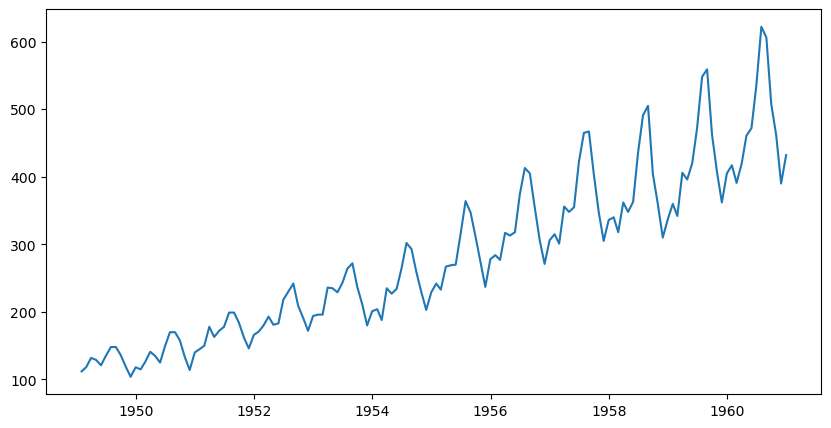

In [ ]:
plt.figure(figsize=(10, 5))
plt.plot(Y_hat_insample['ds'], Y_hat_insample['y'], label='True')
plt.plot(Y_hat_insample['ds'], Y_hat_insample['NHITS'], label='Forecast')
plt.axvline(Y_hat_insample['ds'].iloc[-12], color='black', linestyle='--', label='Train-Test Split')
plt.xlabel('Timestamp [t]')
plt.ylabel('Monthly Passengers')
plt.grid()
plt.legend()






In [ ]:
df = Y_hat_insample.reset_index()
df = df.drop(['cutoff','y'],axis=1)
df = df.rename(columns={"NHITS-median": "NHITS"})
df


,unique_id,ds,NHITS,NHITS-lo-99,NHITS-lo-90,NHITS-lo-80,NHITS-hi-80,NHITS-hi-90,NHITS-hi-99
0,1,2024-04-06 14:34:00,0.000619,-0.069442,-0.002947,-0.004998,0.006478,0.007859,0.126015
1,1,2024-04-06 14:35:00,0.002444,-0.085325,-0.017939,-0.004089,0.012526,0.005215,0.135048
2,1,2024-04-06 14:36:00,0.001101,-0.059728,-0.012986,-0.007130,0.015776,0.011226,0.139880
3,1,2024-04-06 14:37:00,0.006550,-0.017865,-0.014795,-0.003875,0.015113,0.010885,0.185981
4,1,2024-04-06 14:38:00,0.005999,-0.089270,-0.006018,-0.006497,0.010675,0.015490,0.192948
...,...,...,...,...,...,...,...,...,...
43195,1,2024-05-06 14:29:00,14292.669922,6382.158203,10683.376953,11284.666016,20560.353516,23688.021484,39945.914062
43196,1,2024-05-06 14:30:00,14480.091797,5354.897949,10830.458008,11140.866211,20639.185547,23532.406250,39223.628906
43197,1,2024-05-06 14:31:00,14326.675781,5211.589844,10670.412109,11217.823242,20723.437500,23377.197266,39901.191406
43198,1,2024-05-06 14:32:00,14317.842773,4845.058594,10907.494141,11326.849609,20801.511719,23866.916016,41011.761719


In [ ]:
Y_df

,ds,y,unique_id
0,2024-04-06 14:33:00,0.0,1
1,2024-04-06 14:34:00,0.0,1
2,2024-04-06 14:35:00,0.0,1
3,2024-04-06 14:36:00,0.0,1
4,2024-04-06 14:37:00,0.0,1
...,...,...,...
43196,2024-05-06 14:29:00,17166.4,1
43197,2024-05-06 14:30:00,16063.2,1
43198,2024-05-06 14:31:00,15312.8,1
43199,2024-05-06 14:32:00,15220.8,1


In [ ]:
#p=matplotlib.colors.LinearSegmentedColormap.from_list("", ["red","violet","blue"])
p = list(["red","blue"])
fig = plot_series(Y_df, df, level=[90], engine="plotly")
# fill='tonexty',  fill='tonexty',
fig.add_trace(go.Scatter(x=df['ds'], y=df['NHITS-lo-99'],  mode='lines', line=dict(color='lightgrey'), name='99% Prediction Interval'))
fig.add_trace(go.Scatter(x=df['ds'], y=df['NHITS-hi-99'],  mode='lines', line=dict(color='lightgrey'), name='99% Prediction Interval'))



fig.show()

In [ ]:
dir(cm)

['Accent',
 'Accent_r',
 'Blues',
 'Blues_r',
 'BrBG',
 'BrBG_r',
 'BuGn',
 'BuGn_r',
 'BuPu',
 'BuPu_r',
 'CMRmap',
 'CMRmap_r',
 'ColormapRegistry',
 'Dark2',
 'Dark2_r',
 'GnBu',
 'GnBu_r',
 'Grays',
 'Greens',
 'Greens_r',
 'Greys',
 'Greys_r',
 'Mapping',
 'OrRd',
 'OrRd_r',
 'Oranges',
 'Oranges_r',
 'PRGn',
 'PRGn_r',
 'Paired',
 'Paired_r',
 'Pastel1',
 'Pastel1_r',
 'Pastel2',
 'Pastel2_r',
 'PiYG',
 'PiYG_r',
 'PuBu',
 'PuBuGn',
 'PuBuGn_r',
 'PuBu_r',
 'PuOr',
 'PuOr_r',
 'PuRd',
 'PuRd_r',
 'Purples',
 'Purples_r',
 'RdBu',
 'RdBu_r',
 'RdGy',
 'RdGy_r',
 'RdPu',
 'RdPu_r',
 'RdYlBu',
 'RdYlBu_r',
 'RdYlGn',
 'RdYlGn_r',
 'Reds',
 'Reds_r',
 'ScalarMappable',
 'Set1',
 'Set1_r',
 'Set2',
 'Set2_r',
 'Set3',
 'Set3_r',
 'Spectral',
 'Spectral_r',
 'Wistia',
 'Wistia_r',
 'YlGn',
 'YlGnBu',
 'YlGnBu_r',
 'YlGn_r',
 'YlOrBr',
 'YlOrBr_r',
 'YlOrRd',
 'YlOrRd_r',
 '_LUTSIZE',
 '__builtins__',
 '__cached__',
 '__doc__',
 '__file__',
 '__loader__',
 '__name__',
 '__package__',
 '